# Pipeline for Analyzing Asters

Today we will extract ATP gradients from an aster dataset. Executing the next few cells will import all the relevant data.

## Imports

In [1]:
# # Packages to locally download data into the notebook:
# import requests
# import zipfile
import glob

#Numpy
import numpy as np

#For image plotting
import skimage.io

#Matplotlib plotting packages
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
import matplotlib.cm as cm

#Movie plotting


#For identifying aster center
from skimage.filters import threshold_otsu, gaussian
from skimage.measure import regionprops
import cv2

#for image registration
from skimage.registration import phase_cross_correlation
import os

# For loading bars
from tqdm.notebook import tqdm as tqdm
import aster_packages

## Importing plotting

In [35]:
#!/usr/bin/env python
# coding: utf-8

# In[ ]:

# Figure Formatting
import matplotlib.pyplot as plt
import matplotlib as mpl

figwidth = 8
plt.rcParams["figure.figsize"] = [figwidth, figwidth * 1105 / 1920
                                  ]  # figure size in inches
plt.rcParams["lines.linewidth"] = 2  # line width in points
plt.rcParams["font.family"] = "serif"
plt.rcParams["font.serif"] = "Times"

plt.rcParams["font.style"] = "normal"
plt.rcParams["font.weight"] = "heavy"
plt.rcParams["font.size"] = 13.0
plt.rcParams["axes.labelweight"] = "bold"  # weight of the x and y labels
plt.rcParams["axes.spines.right"] = True
plt.rcParams[
    "axes.formatter.useoffset"] = True  # If True, the tick label formatter
plt.rcParams["xtick.major.size"] = 10  # major tick size in points
plt.rcParams["xtick.minor.size"] = 4  # minor tick size in points
plt.rcParams["xtick.direction"] = "in"  # direction in, out, or inout
plt.rcParams["xtick.minor.visible"] = True
plt.rcParams["ytick.major.size"] = 10  # major tick size in points
plt.rcParams["ytick.minor.size"] = 4  # minor tick size in points
plt.rcParams["ytick.direction"] = "in"  # direction in, out, or inout
plt.rcParams["ytick.minor.visible"] = True
plt.rcParams["legend.fontsize"] = 10
plt.rcParams[
    "legend.labelspacing"] = 0.1  # the vertical space between the legend entries in fraction of fontsize
plt.rcParams["legend.shadow"] = False
plt.rcParams[
    "legend.frameon"] = True  # whether or not to draw a frame around legend
plt.rcParams[
    'axes.unicode_minus'] = False  # fix glyph error by using normal hyphens
mpl.rc("figure", dpi=200)

In [3]:
import celluloid as cell
import matplotlib.animation as animation

## Initializing Images

In [4]:
def file_to_image(files):
    """
    Takes in a file list and converts to images.
    
    Parameters:
    files: list of file names that you want to read into images
    
    Returns:
    An array of np.int16 images
    """
    im_list = list()
    for file in files:
        im = skimage.io.imread(file)
        im_list.append(im.astype(np.int16))

    return np.array(im_list)

### Cleaning up file paths (OPT)

Comment this section out if you're analyzing data as normal (not all combined into 1 tif). 

### Specifying files

In [5]:
#Choose the experiment file name(located in folder 'Asters'):
file_path = '../../data/aster'
file_folder = '2022-06-28_NCD_ATeam_UMT/2022-06-28_NCD_ATeam_UMT_R4_1'

# #Choose the position(s)/aster(s) of interest:
pos_list = ['Pos1']

#Choose the channels of interest (this is almost always going to be Cherry and iATP)
channel_list = ['GFP', 'CFP', 'Bright', 'Cherry']

#included frames
included_frames = '*2022*.tif'

### Creating image arrays

Comment this section out if your tiff stack is abnormal. 

In [6]:
# Import images
for pos in pos_list:
    for channel in channel_list:

        #creates an empty list with the naming convention
        exec('im_files' + channel + pos + '= []')
        im_files = eval('im_files' + channel + pos)
        
        #appends all the file names
        im_files.append(
            np.sort(
                glob.glob(file_path + '/' + file_folder + '/' + pos + '/' + channel + '/' +
                          included_frames)))

        #Reads the files as images
        exec('im_array' + channel + pos + ' = file_to_image(im_files[0])')
        print('im_array' + channel + pos)

im_arrayGFPPos1
im_arrayCFPPos1
im_arrayBrightPos1
im_arrayCherryPos1


### Reading bg images

In [7]:
#Choose the dark ims file name(located in folder 'Asters'):
file_path = '../../data/aster/2022-06-15_Ncd_ATeam_Victor+Cathy/2022-06-13_Ncd_ATeam_Victor+cathy_darkims'

im_MT_dark = skimage.io.imread(
    file_path + '/' + '*C1*.ome.tif'
).astype(np.int16)

im_GFP_dark = skimage.io.imread(
    file_path + '/' + '*C2*.ome.tif'
).astype(np.int16)

im_CFP_dark = skimage.io.imread(
    file_path + '/' + '*C3*.ome.tif'
).astype(np.int16)

im_Cherry_dark = skimage.io.imread(
    file_path + '/' + '*C4*.ome.tif'
).astype(np.int16)

### Param calibration

In [22]:
#Length Calibration (microns to pixels)
um_per_pixel = 0.59

#Image dims
w_px, h_px = 1920, 1200  #pixels
w_um, h_um = w_px * um_per_pixel, h_px * um_per_pixel  # microns

#min area thresh (IN PIXELS)
area_thresh = 1000

#Fontsize
f_small, f_big = 13, 15

#??
winsize = 200
thickness = 20
scale = 5

#Total number of imported images per channel
total_frames = len(im_arrayGFPPos1) - 1

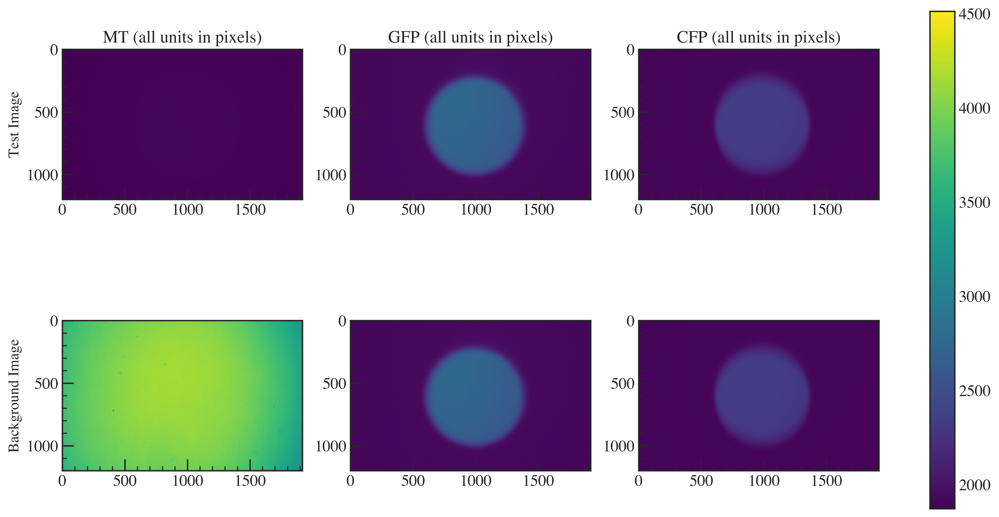

In [9]:
frame = 3
im_MT = im_arrayBrightPos1[frame]
im_CFP = im_arrayCFPPos1[frame]
im_GFP = im_arrayGFPPos1[frame]
im_Cherry = im_arrayCherryPos1[frame]
# im_Cherry = im_Cherry_dark

#define colorbar max and min
colorbar_max = np.percentile(im_GFP, 100)
colorbar_min = np.percentile(im_CFP, 0)

#define plot
fig, ax = plt.subplots(2, 3, figsize=(16, 8))
cmap = cm.get_cmap('viridis')
normalizer = Normalize(colorbar_min, colorbar_max)
cb_setting = cm.ScalarMappable(norm=normalizer)

#define each subplot
# ax[0, 0].imshow(im_MT)
ax[0, 0].imshow(im_Cherry)
ax[0, 0].set_title('MT (all units in pixels)', fontsize=f_big)
ax[0, 0].set_ylabel('Test Image', fontsize=f_small)

ax[0, 1].imshow(im_GFP)
ax[0, 1].set_title('GFP (all units in pixels)', fontsize=f_big)

ax[0, 2].imshow(im_CFP)
ax[0, 2].set_title('CFP (all units in pixels)', fontsize=f_big)

#subplots: setting bg plots
ax[1, 0].imshow(im_MT)
ax[1, 0].set_ylabel('Background Image', fontsize=f_small)

ax[1, 1].imshow(im_GFP)

ax[1, 2].imshow(im_CFP)

fig.colorbar(cb_setting, ax=ax.ravel().tolist())

### Subtracting bg image

In [10]:
# subtracting bg image

im_arrayBrightPos1_bs = im_arrayBrightPos1 - im_MT_dark

# im_arrayGFPPos1_bs = im_arrayGFPPos1 - im_GFP_dark
# im_arrayCFPPos1_bs = im_arrayCFPPos1 - im_CFP_dark
# im_arrayCherryPos1_bs = im_arrayCherryPos1 - im_Cherry_dark

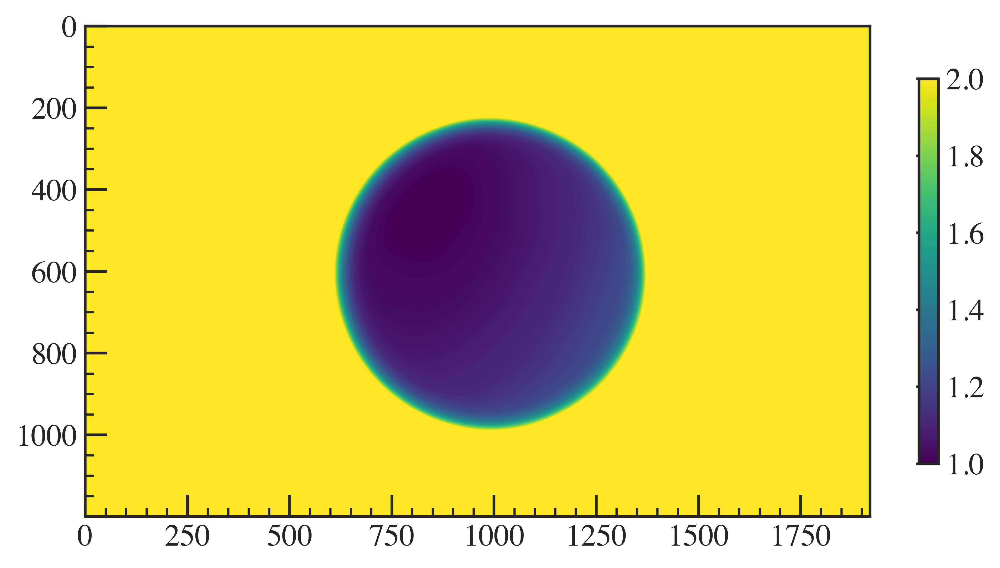

In [11]:
GFP_zero = im_arrayGFPPos1[0]
CFP_zero = im_arrayCFPPos1[0]
Cherry_zero = im_arrayCherryPos1[0]

GFP_norm_mat = aster_packages.norm_mat_fn_iATP(GFP_zero, im_GFP_dark)
CFP_norm_mat = aster_packages.norm_mat_fn_iATP(CFP_zero, im_CFP_dark)
Cherry_norm_mat = aster_packages.norm_mat_fn_iATP(Cherry_zero, im_Cherry_dark)

plt.imshow(GFP_norm_mat, vmin = 1, vmax = 2)
plt.colorbar(shrink = 0.7)

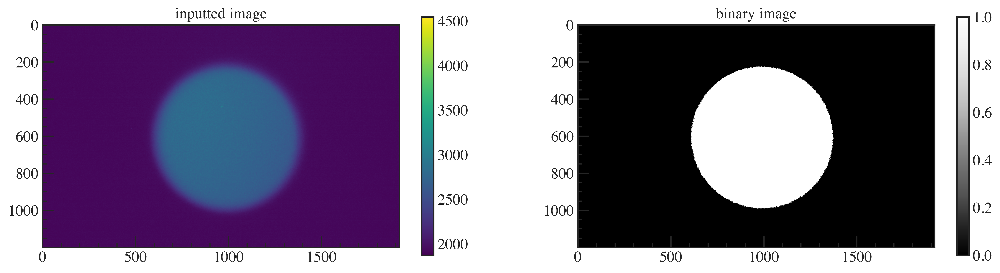

In [12]:
im_arrayGFPPos1 = im_arrayGFPPos1.astype(float)
im_arrayCFPPos1 = im_arrayCFPPos1.astype(float)
im_arrayCherryPos1 = im_arrayCherryPos1.astype(float)

im_binary = aster_packages.binary_im_generator(GFP_zero)
GFP_norm_mask = GFP_norm_mat * im_binary
CFP_norm_mask = CFP_norm_mat * im_binary

im_arrayGFPPos1_norm = GFP_norm_mask * im_arrayGFPPos1
im_arrayCFPPos1_norm = CFP_norm_mask * im_arrayCFPPos1
im_arrayCherryPos1_norm = im_arrayCherryPos1

In [13]:
im_arrayGFPPos1_bs = im_arrayGFPPos1_norm
im_arrayCFPPos1_bs = im_arrayCFPPos1_norm
im_arrayCherryPos1_bs = im_arrayCherryPos1_norm

### Crop

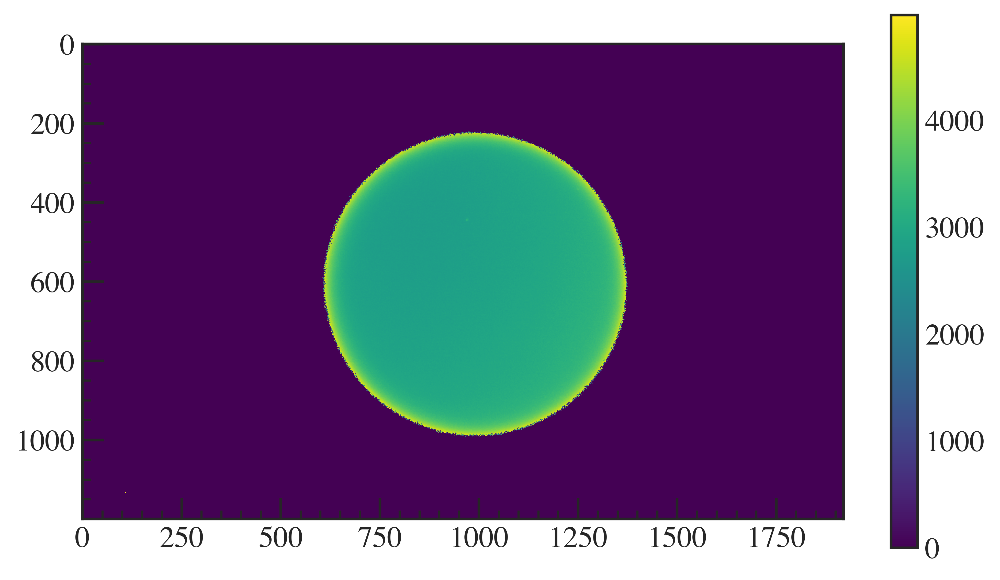

In [14]:
#set crop pixel values
tc_ymin, tc_ymax, tc_xmin, tc_xmax = 475, 655, 870, 1040 #for 'tight crop'
#define crop window
tight_crop = np.s_[tc_ymin:tc_ymax, tc_xmin:tc_xmax]

#set crop pixel values
wc_ymin, wc_ymax, wc_xmin, wc_xmax = 515, 615, 900, 1010  #for 'tight crop'
#define crop window
wide_crop = np.s_[wc_ymin:wc_ymax, wc_xmin:wc_xmax]

TEMP = im_arrayGFPPos1_bs[1]
#show the crop
plt.imshow(TEMP,vmin=np.percentile(TEMP, 0),
          vmax=np.percentile(TEMP, 99.99))
plt.colorbar()

Find the center for each image

### Center

In [15]:
c_ymin, c_ymax, c_xmin, c_xmax = 100, 900, 700, 1500
# define crop window
crop = np.s_[c_ymin:c_ymax, c_xmin:c_xmax]

### Center (w/ Gaussian blur)

In [16]:
c_ymin, c_ymax, c_xmin, c_xmax = 100, 900, 700, 1500

In [17]:
im = im_arrayBrightPos1_bs[30]

dst = gaussian(im[crop], sigma=50)
thresh = np.percentile(dst, 99)
binary = (dst>thresh).astype(np.uint8)

#create a contour
contours, hierarchy = cv2.findContours(binary, 1, 2)

In [18]:
cnt = np.array(contours)
cnt = np.squeeze(cnt)

cnt[:,0] = cnt[:,0] + c_xmin


Find what the center vcalues are for full sized image

In [19]:
#init empty lists for center vals, radius, frame #
centers_tc = []
radii = []
frame_num = []
contours_plot = []

#for loop thru MT images
for i, im in tqdm(enumerate(im_arrayCherryPos1_bs)):
    #crop image for center identification

    #gaussian blur
    dst = gaussian(im[crop], sigma=50)
    thresh = threshold_otsu(dst)
#     thresh = np.percentile(dst, 98.5)

    binary = (dst>thresh).astype(np.uint8)
    
    #create a contour
    contours, hierarchy = cv2.findContours(binary, 1, 2)

    #iterate through contours (for most connected region)
    max_area = 0
    max_index = None

    for j, contour in enumerate(contours):
        area = cv2.contourArea(contour)
        if area > max_area:
            max_area = area
            max_index = j

    if max_area >= area_thresh:
        cnt = contours[max_index]
        (x, y), radius = cv2.minEnclosingCircle(cnt)
        centers_tc.append([x + c_xmin, y + c_ymin])
        radii.append(radius)
        frame_num.append(i)
        
        cnt = np.array(cnt)
        cnt = np.squeeze(cnt)
        cnt[:,0] += c_xmin
        cnt[:,1] += c_ymin
        contours_plot.append(cnt)
        
    else:
        print("**CENTER NOT FOUND**")
        cnt = contours[max_index]
        (x, y), radius = cv2.minEnclosingCircle(cnt)
        centers_tc.append([x + c_xmin, y + c_ymin])
        radii.append(radius)
#         frame_num.append(i)
        
        cnt = np.array(cnt)
        cnt = np.squeeze(cnt)
        cnt[:,0] += c_xmin
        cnt[:,1] += c_ymin
        contours_plot.append(cnt)
        
centers_tc = np.array(centers_tc)
radii = np.array(radii)
frame_num = np.array(frame_num)

0it [00:00, ?it/s]

In [20]:
centers = []
for center in centers_tc:
    center_x = int(center[0])
    center_y = int(center[1])
    centers.append([center_x, center_y])
centers = np.array(centers)

(400.0, 700.0)

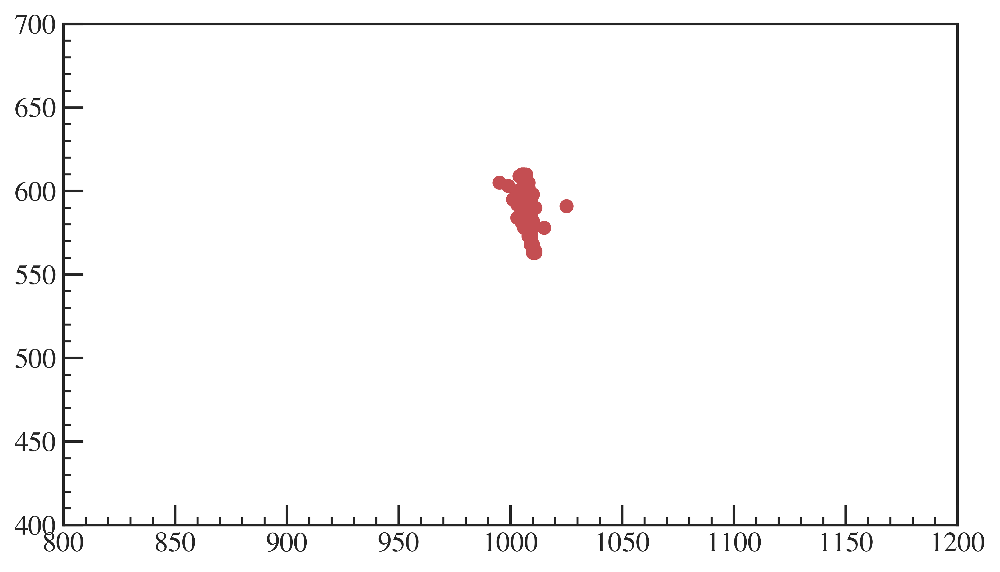

In [21]:
#TEST: plotting all centers

plt.figure()

for i in range(np.shape(centers)[0]):
    plt.scatter(centers[i, 0], centers[i, 1], color='r')

plt.xlim(800, 1200)
plt.ylim(400, 700)

## Making video

  0%|          | 0/232 [00:00<?, ?it/s]

0it [00:00, ?it/s]

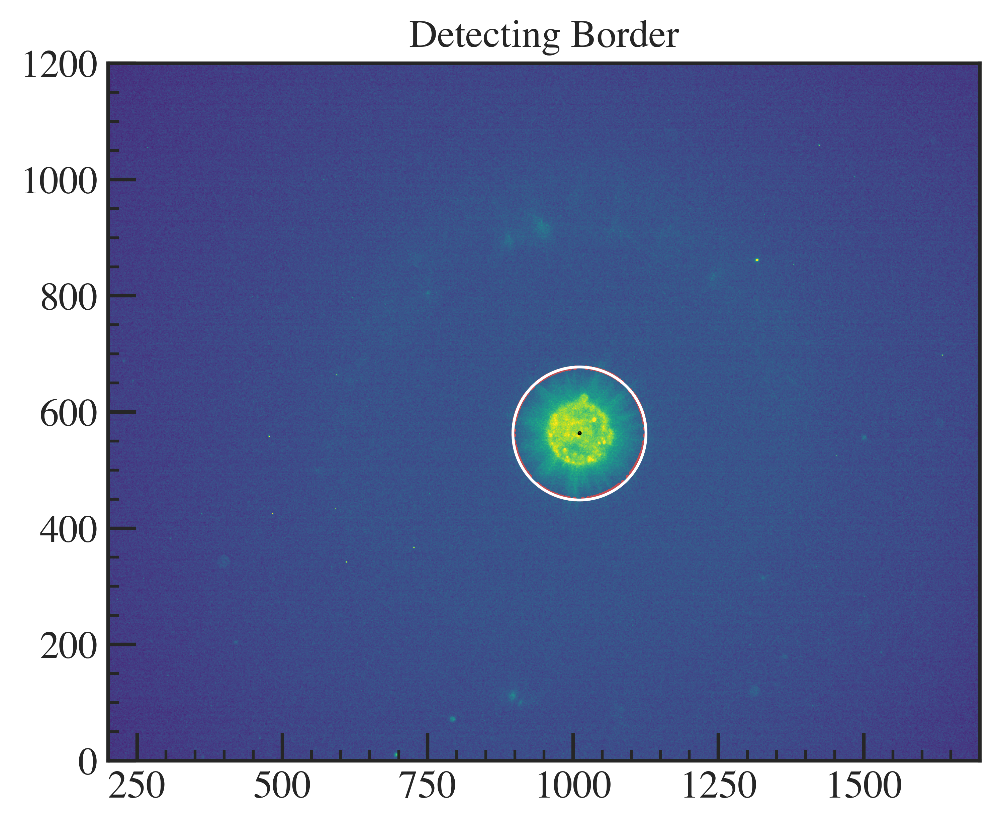

In [23]:
#TEST: checking ALL FRAMES centers (only run once please)
ims = []
cmap = cm.get_cmap('viridis')
normalizer = Normalize(colorbar_min, colorbar_max)
cb_setting = cm.ScalarMappable(norm=normalizer)
fig, ax = plt.subplots()

ax.set_xlim([200, 1700])
ax.set_ylim([0, 1200])
ax.set_title("Detecting Border")

camera = cell.Camera(fig)

for i in tqdm(range(total_frames)):
    im_temp = im_arrayCherryPos1_bs[i]
    im = ax.imshow(im_temp,
                   vmin=np.percentile(im_temp, 0),
                   vmax=np.percentile(im_temp, 99.99),
                   animated=True,
                   zorder=0)

    ax.scatter(contours_plot[i][:, 0],
               contours_plot[i][:, 1],
               color='r',
               s=0.2)
    ax.scatter(centers_tc[i, 0], centers_tc[i, 1], color='black', s=0.2)

    circle1 = plt.Circle((centers[i, 0], centers[i, 1]),
                         radii[i],
                         fill=False,
                         color='w')
    ax.add_patch(circle1)
    camera.snap()

animation = camera.animate()
#tqdm(animation.save("../../analyzed_data/aster/movie_prev.mp4"))

## Register

Register images

In [24]:
#Empty list to record how much CFP (probe) channel is shifted w.r.t. GFP (ATP is bound) channel
shifts = []
total_frames = 232

for i in range(total_frames):
    shift, error, _ = phase_cross_correlation(
        im_arrayGFPPos1_bs[i][tight_crop], im_arrayCFPPos1_bs[i][tight_crop])
    shifts.append(shift)

shifts = np.array(shifts)

## Getting plotting data

In [25]:
def create_circular_mask(h, w, center=None, radius=None):

    if center is None: # use the middle of the image
        center = (int(w/2), int(h/2))
    if radius is None: # use the smallest distance between the center and image walls
        radius = min(center[0], center[1], w-center[0], h-center[1])

    Y, X = np.ogrid[:h, :w]
    dist_from_center = np.sqrt((X - center[0])**2 + (Y-center[1])**2)
        
    mask = dist_from_center <= radius
    return mask

In [26]:
#cropped aster images
im_arrayGFPPos1_plot = []
im_arrayCFPPos1_plot = []
im_arrayBrightPos1_plot = []
im_arrayCherryPos1_plot = []

ratios_plot = []

#Traces for asters
GFP_trace_pts = []
CFP_trace_pts = []
MT_trace_pts = []
Cherry_trace_pts = []

ratios_trace_pts = []

for i in tqdm(frame_num):

    #Set the window parameters
    i_min = int(centers[i][0] - winsize)
    i_max = int(centers[i][0] + winsize)
    j_min = int(centers[i][1] - winsize)
    j_max = int(centers[i][1] + winsize)

    #demi-variable for shift
    shift_j = int(shifts[i][0])
    shift_i = int(shifts[i][1])

    #set GFP and CFP windows
    winGFP = np.s_[j_min:j_max, i_min:i_max]
    winCFP = np.s_[(j_min - shift_j):(j_max - shift_j),
                   (i_min - shift_i):(i_max - shift_i)]
    winCherry = np.s_[j_min:j_max, i_min:i_max]

    #Append the plotting images
    [h, w] = np.shape(im_arrayGFPPos1_bs[i])
    mask = 1 * create_circular_mask(h, w, centers[i], thickness)

    im_arrayGFPPos1_plot.append(im_arrayGFPPos1_bs[i][winGFP])
    im_arrayCFPPos1_plot.append(im_arrayCFPPos1_bs[i][winCFP])
    im_arrayBrightPos1_plot.append(im_arrayBrightPos1_bs[i][winCFP])
    im_arrayCherryPos1_plot.append(im_arrayCherryPos1_bs[i][winCherry])
    #for now MT same as CFP shifts, running the shift cell seems closest to CFP

    ratio = im_arrayGFPPos1_bs[i][winGFP] / im_arrayCFPPos1_bs[i][winCFP]
    ratios_plot.append(ratio)

im_arrayGFPPos1_plot = np.array(im_arrayGFPPos1_plot)
im_arrayCFPPos1_plot = np.array(im_arrayCFPPos1_plot)
im_arrayBrightPos1_plot = np.array(im_arrayBrightPos1_plot)
ratios_plot = np.array(ratios_plot)

pos_xaxis = np.linspace(-winsize, winsize, 2 * winsize)

  0%|          | 0/232 [00:00<?, ?it/s]

### Plotting analysis

## Radial trace

### Parameters

In [27]:
r_inner_um = radii[100]/2
r_outer_um = r_inner_um * 2
vmax_default = 99.9

W_half = int(0.5 * w)

### Helper fxns

In [28]:
def profile_fn(im,
               r_min=2.5,
               dr=1.5,
               r_max=None,
               avg_method='mean',
               n_positions=100,
               n_wedge=16):
    """
    Calculate the radial intensity profile of an image, 
    assuming that the (0,0) coordinate is at the center of the image.
    
    Parameters
    ----------
    im : numpy array
        The cropped image of the aster (grayscale).
      
    r_min : float
        Minimum radius beyond which the intensity profile is calculated [px].
    
    dr : float
        Radial binning size [px].
    
    avg_method : string
        The method used for doing a radial average of intensities.
        'median' - median averaging
        'mean' - mean averaging
        
    n_positions : integer
        Number of uniformly spaced radial positions where the average
        intensity is calculated.
        
    n_wedge : integer
        Number of angular bins
        
                      
    Returns
    -------
    profile_output : dictionary
        Dictionary of different outputs listed below
    
      r_unif_ls : numpy array
          Uniformly spaced radii where the average intensity is evaluated.
          
      avg_ls : numpy array
          Average intensities evaluated at 'n_positions' different uniformly
          spaced radii.
          
      std_ls : numpy array
          Standard deviations of intensity values in differents wedges
          
      avg_bin_mat : numpy array
          Two dimensional array to store the average fluorescence values
          at each of 'n_positions' radii and for each angular bin
          
      angles : numpy array
          List of average angles at different bins. E.g., if the upper and
          lower θ-limits are (30° and 60°), then the corresponding element
          in angles will be 45°.
          
      r_ls : numpy array
          Radial distances of all image pixels from the image center.
          
      im_ls : numpy array
          All pixel intensities in the same order as 'r_ls'.
    """

    # Ensure that the image is a numpy array
    if not isinstance(im, np.ndarray):
        im = np.array(im)

    # Dimensions of the image
    H, W = im.shape

    # Array of the radial distance of each point from the center
    x_mat, y_mat = np.meshgrid(np.arange(W), np.arange(H))
    x_center = 0.5 * W - 0.5
    y_center = 0.5 * H - 0.5
    r_mat = np.sqrt((x_mat - x_center)**2 + (y_mat - y_center)**2)
    angle_mat = np.mod(np.arctan2(y_mat - y_center, x_mat - x_center),
                       2 * np.pi)

    # Convert 2d arrays into 1d arrays
    r_ls = r_mat.flatten()
    im_ls = im.flatten()
    angle_ls = angle_mat.flatten()

    # Uniformly spaced radii, starting with r_min and
    # ending with the smallest dimension of the image halved,
    # if r_max is not explicitly specified
    if type(r_max) != np.ndarray:
        r_max = 0.5 * np.min([H, W]) - 0.5

    r_unif_ls = np.linspace(r_min, r_max, n_positions)

    # List of bin angles
    angle_bins = np.radians(np.linspace(0, 360, n_wedge + 1))
    angles = 0.5 * (angle_bins[1:] + angle_bins[0:-1])

    # Matrix to store average profiles in each radial bin
    avg_bin_mat = [[] for _ in range(n_wedge)]

    for i, r in enumerate(r_unif_ls):
        dat = im_ls[(r_ls > r - 0.5 * dr) & (r_ls < r + 0.5 * dr)]
        angle_disk = angle_ls[(r_ls > r - 0.5 * dr) & (r_ls < r + 0.5 * dr)]

        for k in range(n_wedge):
            dat_bin = dat[(angle_disk > angle_bins[k])
                          & (angle_disk <= angle_bins[k + 1])]
            if avg_method == 'median':
                avg_dat_bin = np.median(dat_bin)
            elif avg_method == 'mean':
                avg_dat_bin = np.mean(dat_bin)
            avg_bin_mat[k].append(avg_dat_bin)

    avg_bin_mat = np.array(avg_bin_mat)
    if avg_method == 'median':
        avg_ls = np.median(avg_bin_mat, axis=0)
    elif avg_method == 'mean':
        avg_ls = np.mean(avg_bin_mat, axis=0)
    else:
        raise ValueError('Incorrect averaging method specified.')

    std_ls = np.std(avg_bin_mat, axis=0)

    # Keep only the points inside the disk
    im_ls = im_ls[r_ls <= r_max]
    r_ls = r_ls[r_ls <= r_max]

    profile_output = {
        "r_unif_ls": r_unif_ls,
        "r_unif_ls_um": r_unif_ls * um_per_pixel,
        "avg_ls": avg_ls,
        "std_ls": std_ls,
        "avg_bin_mat": avg_bin_mat,
        "angles": angles,
        "r_ls": r_ls,
        "im_ls": im_ls
    }

    return profile_output

### Wedge plot

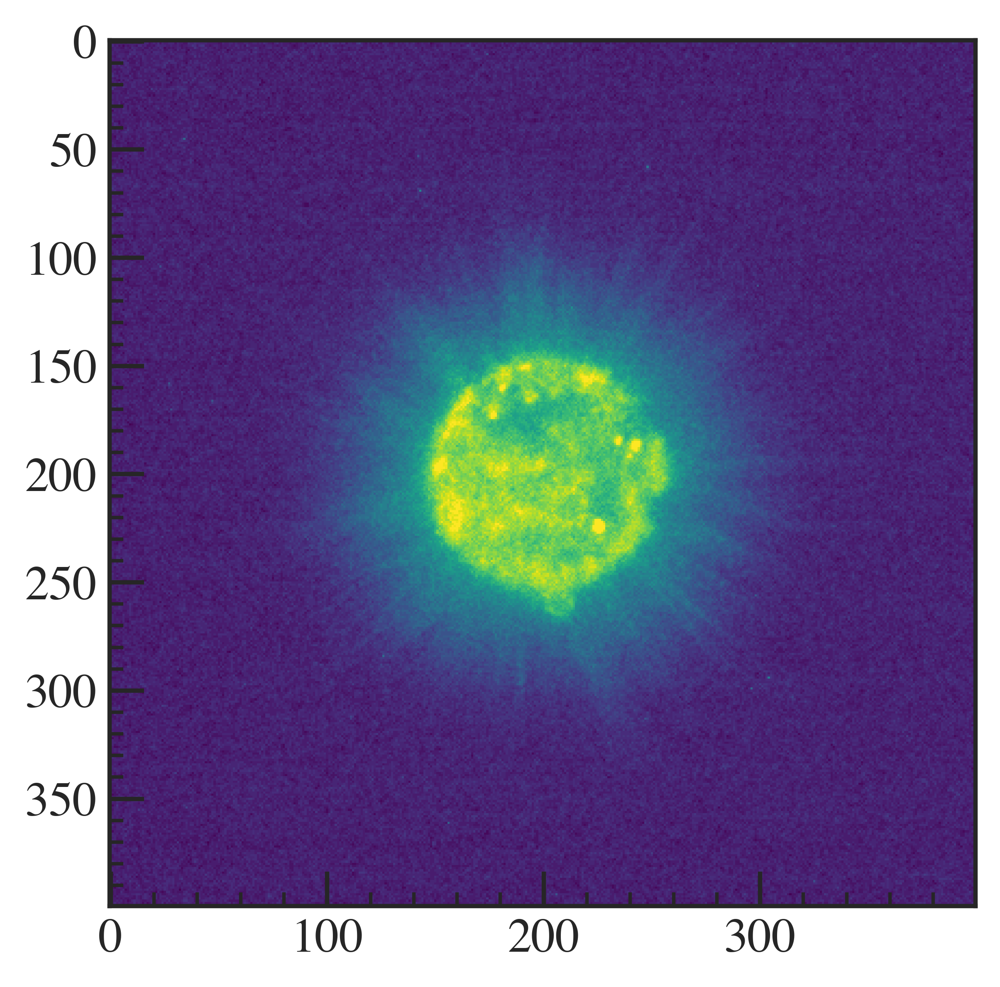

In [29]:
center = centers[100]
im = im_arrayCherryPos1_bs[100][(int(center[1])-winsize): (int(center[1]) + winsize), 
                               (int(center[0])-winsize):(int(center[0])+winsize)]


plt.imshow(im, vmin = np.percentile(im, 0), vmax = np.percentile(im, vmax_default))

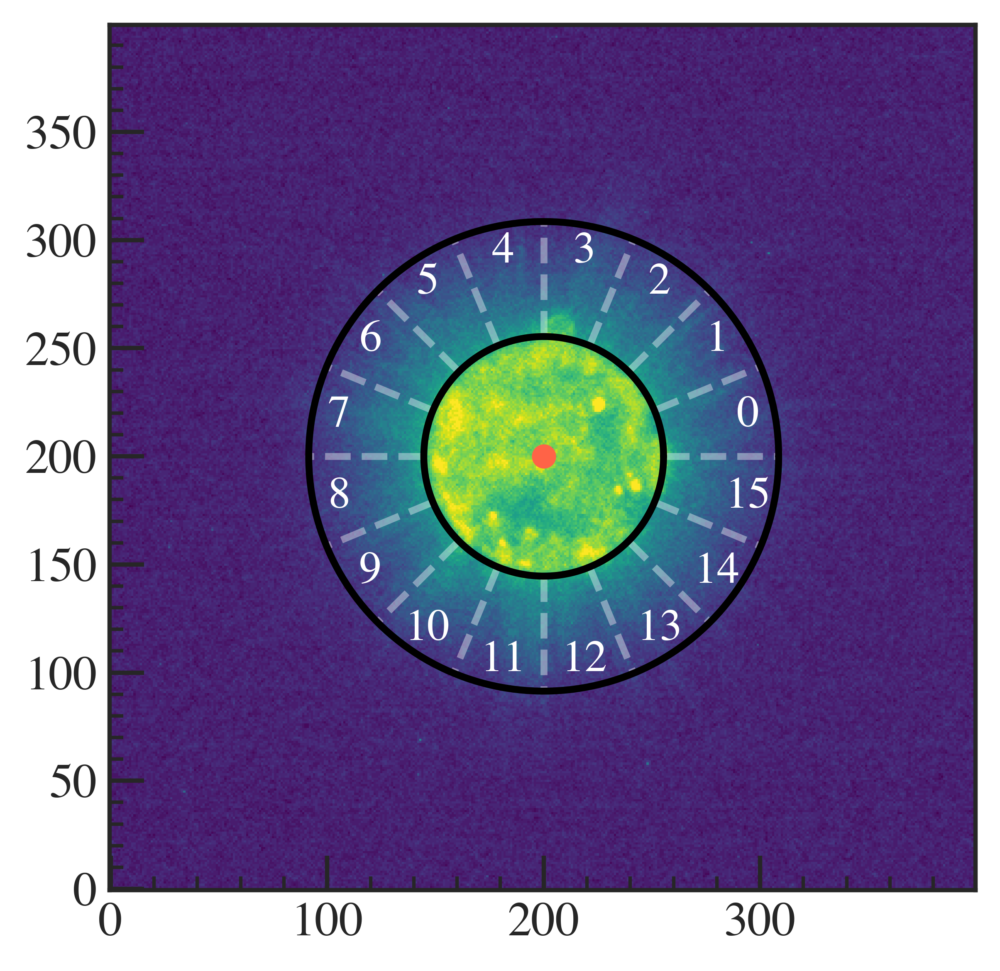

In [30]:
#######################################################################
# --------------- Show aster with boundaries & wedges --------------- #
#######################################################################

center = centers[100]
im = im_arrayCherryPos1_bs[100][int(center[1])-winsize : int(center[1]) + winsize, 
                               int(center[0])-winsize:int(center[0])+winsize]

plt.imshow(im, 
           origin='lower', 
#            extent = (-r_outer_um, r_outer_um, -r_outer_um, r_outer_um),
           vmin = np.percentile(im, 0), vmax = np.percentile(im, vmax_default),
           cmap = "viridis")

n_wedge = 16
angle_bins = np.radians(np.linspace(0,360,n_wedge+1))
angles = 0.5*(angle_bins[1:] + angle_bins[0:-1])

for i in range(len(angle_bins)-1):
    angle = angle_bins[i]
    xx = [r_inner_um*np.cos(angle), 0.98*r_outer_um*np.cos(angle)]
    yy = [r_inner_um*np.sin(angle), 0.98*r_outer_um*np.sin(angle)]
    
    xx = np.array(xx)
    yy = np.array(yy)
    
    xx += winsize
    yy += winsize
    
    plt.plot(xx, yy, '--', color='w', alpha=0.4)

    dangle = angle_bins[1]-angle_bins[0]
    x_text = 0.87*r_outer_um*np.cos(angle+0.5*dangle) + winsize
    y_text = 0.87*r_outer_um*np.sin(angle+0.5*dangle) + winsize
    plt.text(x_text, y_text, str(i), color='w', alpha=1,
             horizontalalignment='center', verticalalignment='center')

thetas = np.linspace(0,2*np.pi,200)

x_circ_inner = r_inner_um*np.cos(thetas) + winsize
y_circ_inner = r_inner_um*np.sin(thetas) + winsize
plt.plot(x_circ_inner, y_circ_inner, color='black', alpha=1)

x_circ_outer = 0.98*r_outer_um*np.cos(thetas) + winsize
y_circ_outer = 0.98*r_outer_um*np.sin(thetas) + winsize
plt.plot(x_circ_outer, y_circ_outer, color='black', alpha=1)
plt.scatter(winsize,winsize, color="tomato")

### Generating profiles

In [31]:
# getting GFP, CFP, MT, Cherry profiles averaged across radial blochs

output_GFP = []
output_CFP = []
output_MT = []
output_Cherry = []
output_ratios = []

num_pos = 100

avg_method_default = 'mean'

for i, frame in tqdm(enumerate(frame_num)):

    prof_GFP = profile_fn(im_arrayGFPPos1_plot[i],
                          r_min=radii[i],
                          r_max=100,
                          avg_method=avg_method_default,
                          n_positions=num_pos)
    prof_CFP = profile_fn(im_arrayCFPPos1_plot[i],
                          r_min=radii[i],
                          r_max=100,
                          avg_method=avg_method_default,
                          n_positions=num_pos)
    prof_MT = profile_fn(im_arrayBrightPos1_plot[i],
                         r_min=radii[i],
                         r_max=100,
                         avg_method=avg_method_default,
                         n_positions=num_pos)
    prof_Cherry = profile_fn(im_arrayCherryPos1_plot[i],
                         r_min=radii[i],
                         r_max=100,
                         avg_method=avg_method_default,
                         n_positions=num_pos)
    prof_ratios = profile_fn(ratios_plot[i],
                             r_min=0,
                             r_max=100,
                             avg_method=avg_method_default,
                             n_positions=num_pos)

    output_GFP.append(prof_GFP)
    output_CFP.append(prof_CFP)
    output_MT.append(prof_MT)
    output_Cherry.append(prof_Cherry)
    output_ratios.append(prof_ratios)

0it [00:00, ?it/s]

/Users/anaduarte/opt/anaconda3/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/Users/anaduarte/opt/anaconda3/lib/python3.8/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


In [44]:
output_ratios[0]['avg_ls']

array([       nan,        nan, 1.03456947, 1.03664518, 1.03583924,
       1.03783798, 1.03557738, 1.03509453, 1.03877388, 1.03691913,
       1.03907213, 1.04073226, 1.03762019, 1.03951183, 1.03776461,
       1.03740574, 1.0360688 , 1.03906213, 1.03856334, 1.03726881,
       1.03905049, 1.03746728, 1.03801228, 1.0392571 , 1.03899659,
       1.03880464, 1.03878771, 1.03971454, 1.04003521, 1.0403159 ,
       1.03827233, 1.03873524, 1.03933267, 1.03862499, 1.03976217,
       1.04011388, 1.03826261, 1.03952251, 1.03888203, 1.04053295,
       1.03920018, 1.03887837, 1.03963912, 1.03806986, 1.04041115,
       1.03861108, 1.03892452, 1.03888594, 1.03893105, 1.04072236,
       1.03959905, 1.0394481 , 1.03893208, 1.03952514, 1.03958414,
       1.0394545 , 1.03945439, 1.03995914, 1.04045861, 1.04020307,
       1.0402974 , 1.04026213, 1.04011097, 1.0380336 , 1.03872574,
       1.04018163, 1.04036498, 1.04085072, 1.0408635 , 1.04064698,
       1.04012774, 1.03971838, 1.04030253, 1.040711  , 1.04001

### Convert to concentration units

In [37]:
def inten_to_conc(array, a, b, c, d):
    return a * ((c - array) / (array - b)) ** (1/d)

In [69]:
output_ratios_conc_units = []
for i in frame_num:
    ratio_conc = inten_to_conc(output_ratios[i]['avg_ls'], 718, 1.46, 0.78, 2.1)
    output_ratios_conc_units.append(ratio_conc)
output_ratios_conc_units = np.array(output_ratios_conc_units)

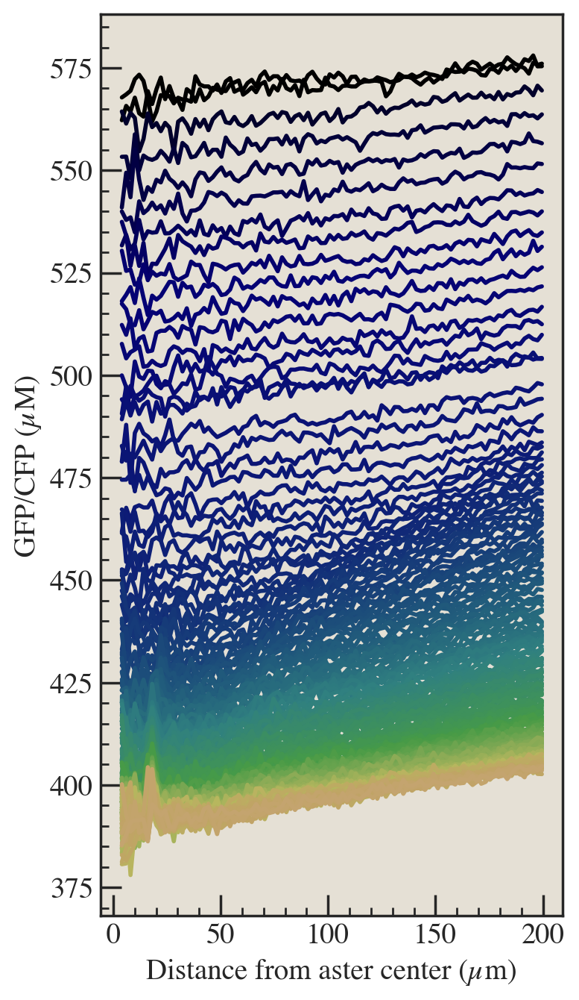

In [70]:
fig, ax = plt.subplots(figsize=(4, 8))
plt.gca().set_prop_cycle(
    plt.cycler('color', plt.cm.gist_earth(np.linspace(0, 0.8,
                                                      len(plot_frames)))))
for i, frame in enumerate(plot_frames):
    ax.plot(output_ratios[frame]['r_unif_ls'],
             output_ratios_conc_units[frame],
             lw=2,
             label=str(round(plot_times[frame], 2)))
#plt.legend(bbox_to_anchor=(1,1), loc="upper left", title = 'Time (min)', facecolor =color_background)
plt.xlabel('Distance from aster center (µm)')
plt.ylabel('GFP/CFP (µM)')
ax.set_facecolor(color_background)

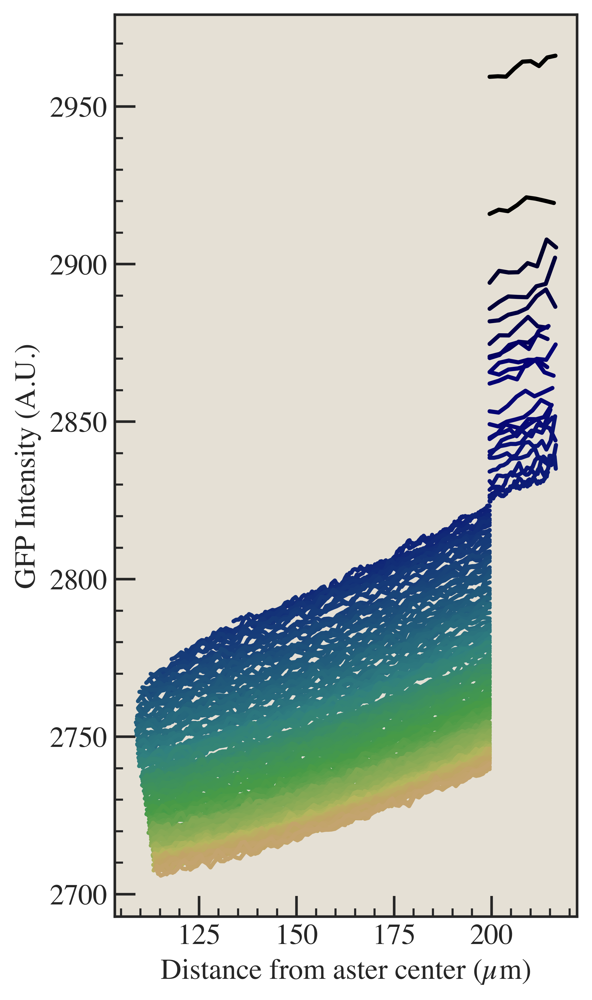

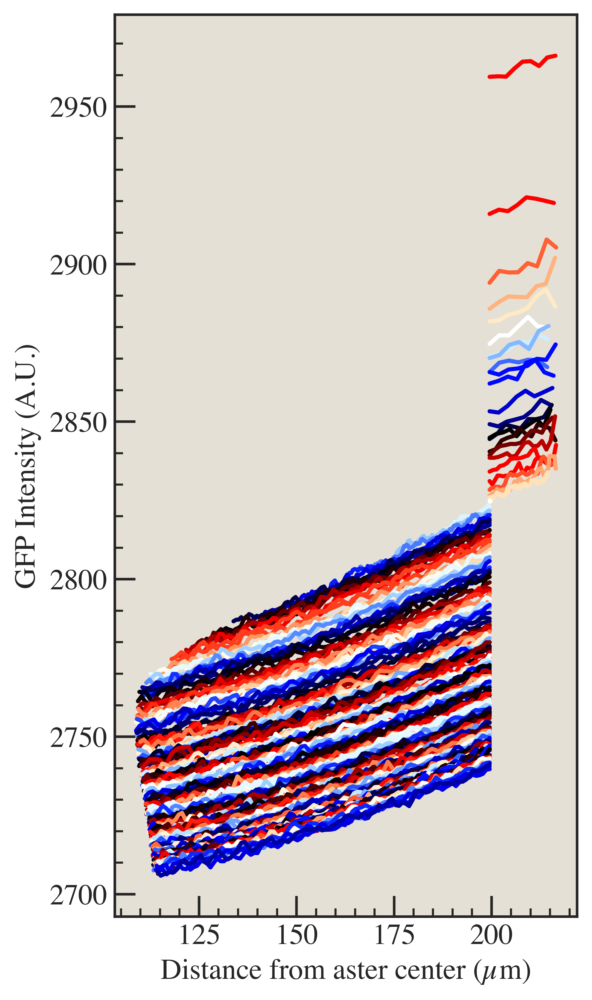

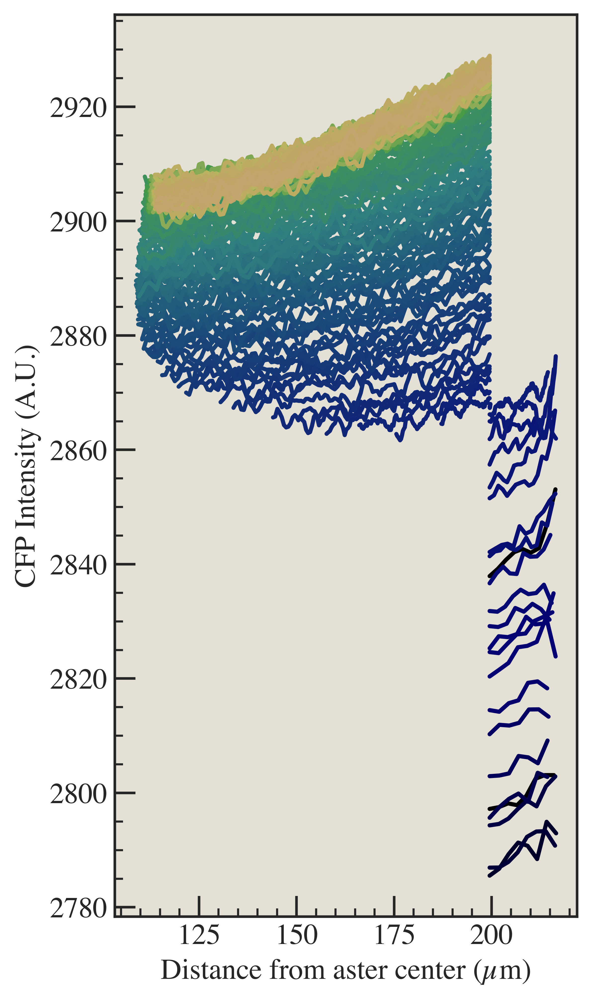

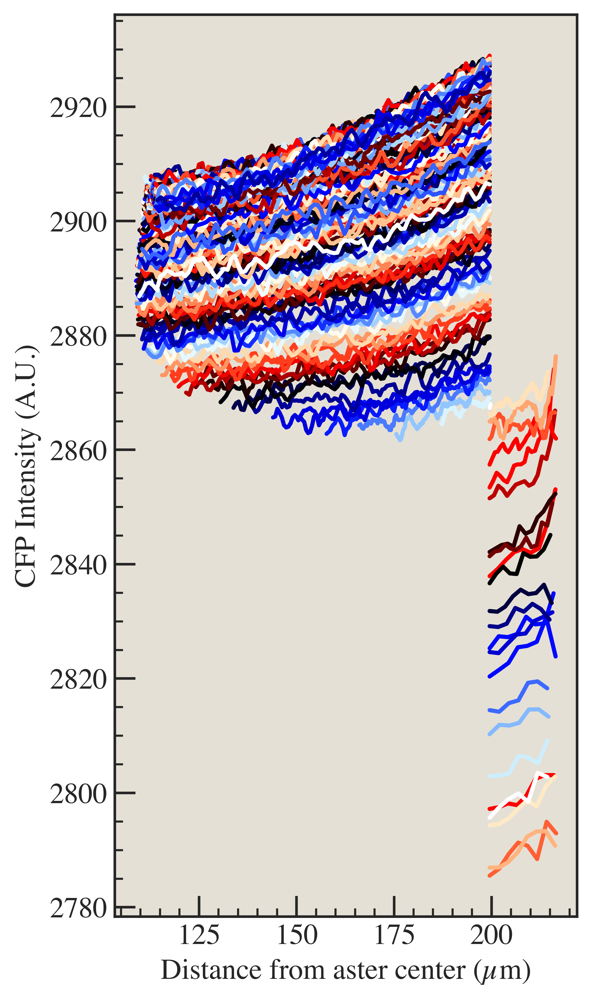

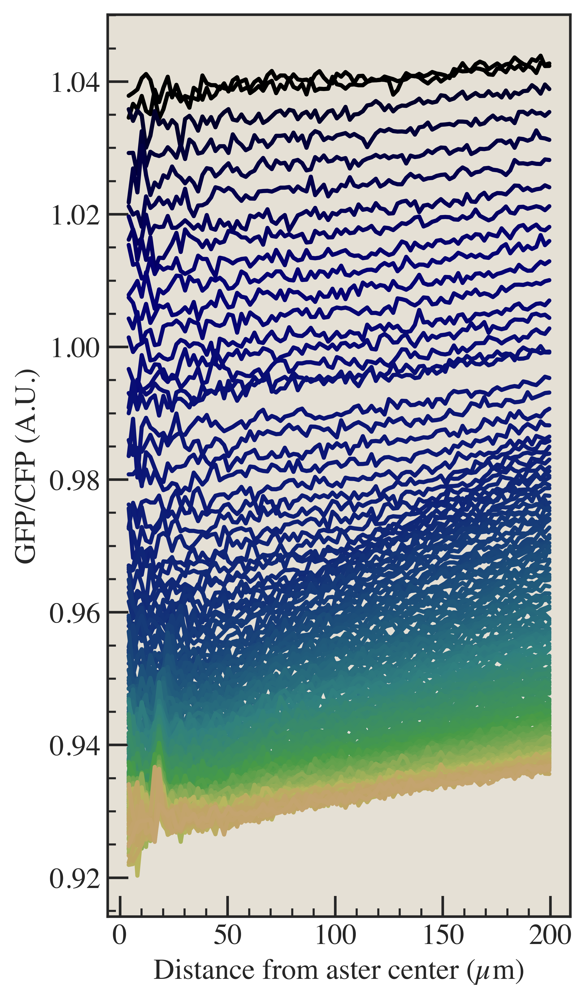

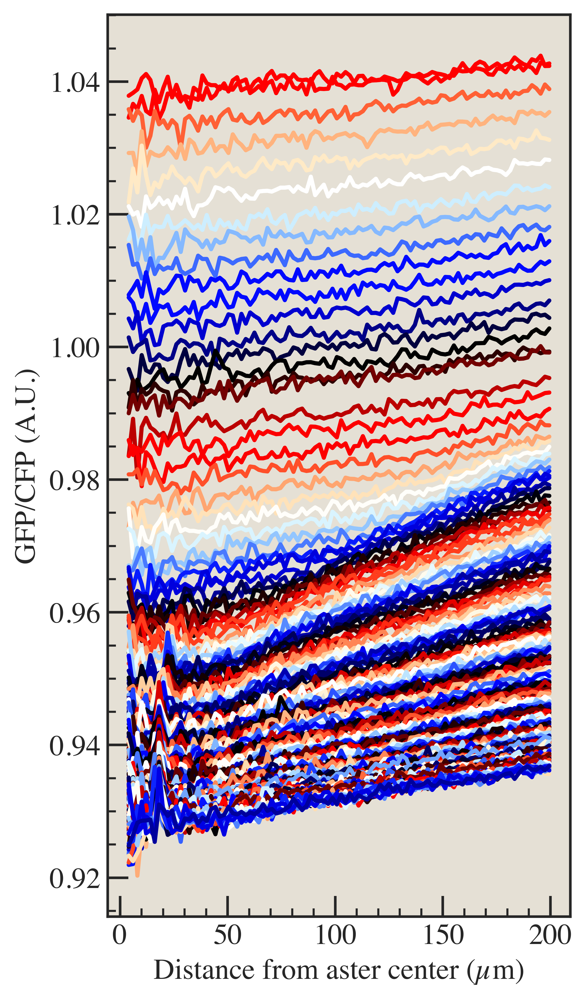

In [32]:
#Define the frames to plot
plot_frames = frame_num[:-2]
plot_times = frame_num * 20 / 60  #min
color_background = '#E5E0D5'

### Plot GFP ###

#--- earth ---#

fig, ax = plt.subplots(figsize=(4, 8))
plt.gca().set_prop_cycle(
    plt.cycler('color', plt.cm.gist_earth(np.linspace(0, 0.8,
                                                      len(plot_frames)))))
for i, frame in enumerate(plot_frames):
    plt.plot(output_GFP[i]['r_unif_ls'],
             output_GFP[i]['avg_ls'],
             lw=2,
             label=str(round(plot_times[i], 2)))
#plt.legend(bbox_to_anchor=(1,1), loc="upper left", title = 'Time (min)', facecolor =color_background)
plt.xlabel('Distance from aster center (µm)')
plt.ylabel('GFP Intensity (A.U.)')
ax.set_facecolor(color_background)

#--- flag ---#

fig, ax = plt.subplots(figsize=(4, 8))
plt.gca().set_prop_cycle(
    plt.cycler('color', plt.cm.flag(np.linspace(0, 0.8, len(plot_frames)))))
for i, frame in enumerate(plot_frames):
    plt.plot(output_GFP[i]['r_unif_ls'],
             output_GFP[i]['avg_ls'],
             lw=2,
             label=str(round(plot_times[i], 2)))
#plt.legend(bbox_to_anchor=(1,1), loc="upper left", title = 'Time (min)', facecolor =color_background)
plt.xlabel('Distance from aster center (µm)')
plt.ylabel('GFP Intensity (A.U.)')
ax.set_facecolor(color_background)

### Plot CFP ###

#--- earth ---#

fig, ax = plt.subplots(figsize=(4, 8))
plt.gca().set_prop_cycle(
    plt.cycler('color', plt.cm.gist_earth(np.linspace(0, 0.8,
                                                      len(plot_frames)))))
for i, frame in enumerate(plot_frames):
    plt.plot(output_CFP[i]['r_unif_ls'],
             output_CFP[i]['avg_ls'],
             lw=2,
             label=str(round(plot_times[i], 2)))
#plt.legend(bbox_to_anchor=(1,1), loc="upper left", title = 'Time (min)', facecolor =color_background)
plt.xlabel('Distance from aster center (µm)')
plt.ylabel('CFP Intensity (A.U.)')
ax.set_facecolor(color_background)

#--- flag ---#

fig, ax = plt.subplots(figsize=(4, 8))
plt.gca().set_prop_cycle(
    plt.cycler('color', plt.cm.flag(np.linspace(0, 0.8, len(plot_frames)))))
for i, frame in enumerate(plot_frames):
    plt.plot(output_CFP[i]['r_unif_ls'],
             output_CFP[i]['avg_ls'],
             lw=2,
             label=str(round(plot_times[i], 2)))
#plt.legend(bbox_to_anchor=(1,1), loc="upper left", title = 'Time (min)', facecolor =color_background)
plt.xlabel('Distance from aster center (µm)')
plt.ylabel('CFP Intensity (A.U.)')
ax.set_facecolor(color_background)

### Plot Ratio ###

#--- earth ---#

fig, ax = plt.subplots(figsize=(4, 8))
plt.gca().set_prop_cycle(
    plt.cycler('color', plt.cm.gist_earth(np.linspace(0, 0.8,
                                                      len(plot_frames)))))
for i, frame in enumerate(plot_frames):
    plt.plot(output_ratios[i]['r_unif_ls'],
             output_ratios[i]['avg_ls'],
             lw=2,
             label=str(round(plot_times[i], 2)))
#plt.legend(bbox_to_anchor=(1,1), loc="upper left", title = 'Time (min)', facecolor =color_background)
plt.xlabel('Distance from aster center (µm)')
plt.ylabel('GFP/CFP (A.U.)')
ax.set_facecolor(color_background)

#--- flag ---#

fig, ax = plt.subplots(figsize=(4, 8))
plt.gca().set_prop_cycle(
    plt.cycler('color', plt.cm.flag(np.linspace(0, 0.8, len(plot_frames)))))
for i, frame in enumerate(plot_frames):
    plt.plot(output_ratios[i]['r_unif_ls'],
             output_ratios[i]['avg_ls'],
             lw=2,
             label=str(round(plot_times[i], 2)))
#plt.legend(bbox_to_anchor=(1,1), loc="upper left", title = 'Time (min)', facecolor =color_background)
plt.xlabel('Distance from aster center (µm)')
plt.ylabel('GFP/CFP (A.U.)')
ax.set_facecolor(color_background)


### Final radial traces

RuntimeError: generator raised StopIteration

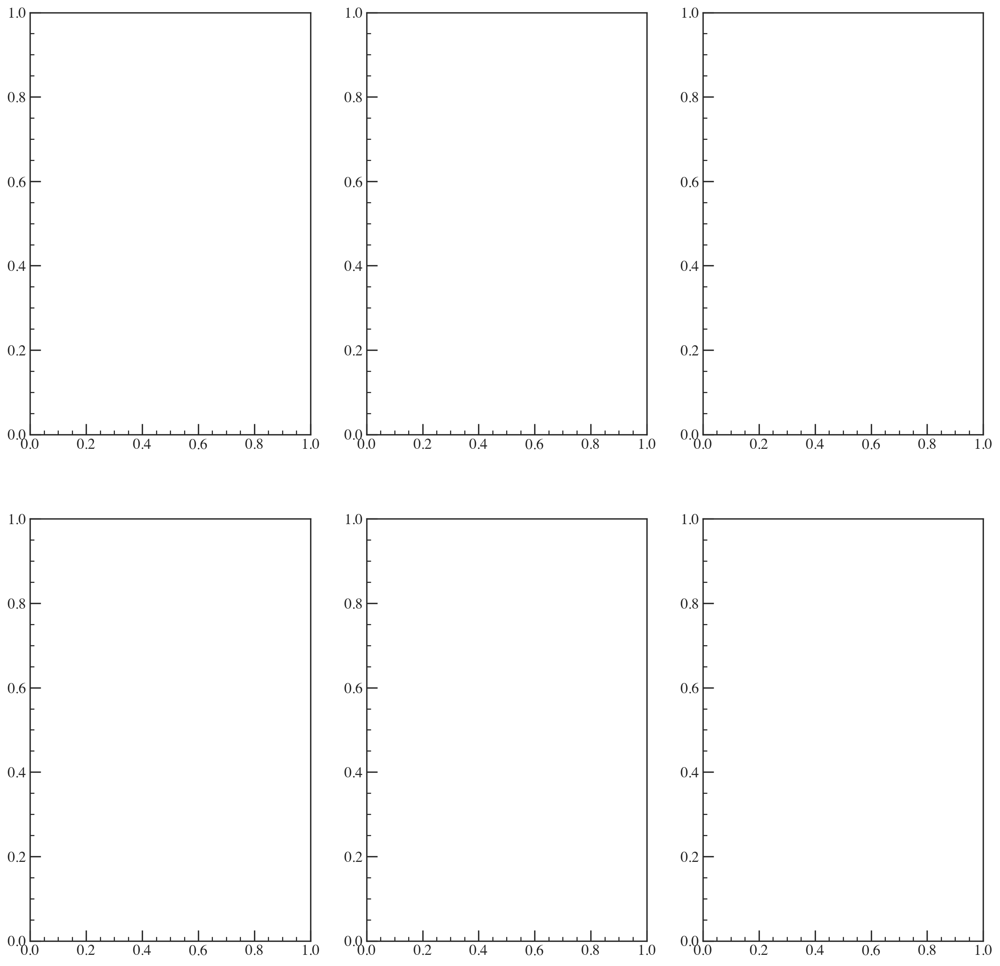

In [36]:
#Define the frames to plot
plot_frames = frame_num[:-2]
plot_times = frame_num * 20 / 60  #min
mod_num = 10

upper_bound_cycler = int(len(ratios_trace_pts) / mod_num)

fig, ax = plt.subplots(2, 3, figsize=(16, 16))
#plt.gca().set_prop_cycle(plt.cycler('color', plt.cm.gist_earth(np.linspace(0, 0.8, len(plot_frames)))))
ax[0, 0].set_prop_cycle(
    plt.cycler(
        'color',
        plt.cm.gist_earth(
            np.linspace(0.1, 0.80, upper_bound_cycler))))
ax[0, 1].set_prop_cycle(
    plt.cycler(
        'color',
        plt.cm.gist_earth(
            np.linspace(0.1, 0.80, upper_bound_cycler))))
ax[0, 2].set_prop_cycle(
    plt.cycler(
        'color',
        plt.cm.gist_earth(
            np.linspace(0.1, 0.80, upper_bound_cycler))))
ax[1, 0].set_prop_cycle(
    plt.cycler(
        'color',
        plt.cm.gist_earth(
            np.linspace(0.1, 0.80, upper_bound_cycler))))
ax[1, 1].set_prop_cycle(
    plt.cycler(
        'color',
        plt.cm.gist_earth(
            np.linspace(0.1, 0.80, upper_bound_cycler))))
ax[1, 2].set_prop_cycle(
    plt.cycler(
        'color',
        plt.cm.gist_earth(
            np.linspace(0.1, 0.80, upper_bound_cycler))))

for i, frame in enumerate(plot_frames):
    if (i % mod_num == 0):
        ax[0, 0].plot(output_GFP[i]['r_unif_ls_um'],
                      output_GFP[i]['avg_ls'],
                      lw=2,
                      label=str(round(plot_times[i], 2)))
#plt.legend(bbox_to_anchor=(1,1), loc="upper left", title = 'Time (min)', facecolor =color_background)
ax[0, 0].set_xlabel('Distance from aster center (µm)')
ax[0, 0].set_ylabel('GFP Intensity (A.U.)')
ax[0, 0].set_facecolor(color_background)

for i, frame in enumerate(plot_frames):
    if (i % mod_num == 0):
        ax[0, 1].plot(output_CFP[i]['r_unif_ls_um'],
                      output_CFP[i]['avg_ls'],
                      lw=2,
                      label=str(round(plot_times[i], 2)))
#plt.legend(bbox_to_anchor=(1,1), loc="upper left", title = 'Time (min)', facecolor =color_background)
ax[0, 1].set_xlabel('Distance from aster center (µm)')
ax[0, 1].set_ylabel('CFP Intensity (A.U.)')
ax[0, 1].set_facecolor(color_background)

for i, frame in enumerate(plot_frames):
    if (i % mod_num == 0):
        ax[0, 2].plot(output_ratios[i]['r_unif_ls_um'],
                      output_ratios[i]['avg_ls'],
                      lw=2,
                      label=str(round(plot_times[i], 2)))
#plt.legend(bbox_to_anchor=(1,1), loc="upper left", title = 'Time (min)', facecolor =color_background)
ax[0, 2].set_xlabel('Distance from aster center (µm)')
ax[0, 2].set_ylabel('GFP/CFP (A.U.)')
ax[0, 2].set_facecolor(color_background)

# ----- Flag same as above ----#
for i, frame in enumerate(plot_frames):
    if (i % mod_num == 0):
        ax[1, 0].plot(output_GFP[i]['r_unif_ls_um'],
                      output_GFP[i]['avg_ls'],
                      lw=2,
                      label=str(round(plot_times[i], 2)))
#plt.legend(bbox_to_anchor=(1,1), loc="upper left", title = 'Time (min)', facecolor =color_background)
ax[1, 0].set_xlabel('Distance from aster center (µm)')
ax[1, 0].set_ylabel('GFP Intensity (A.U.)')
ax[1, 0].set_facecolor(color_background)

for i, frame in enumerate(plot_frames):
    if (i % mod_num == 0):
        ax[1, 1].plot(output_CFP[i]['r_unif_ls_um'],
                      output_CFP[i]['avg_ls'],
                      lw=2,
                      label=str(round(plot_times[i], 2)))
#plt.legend(bbox_to_anchor=(1,1), loc="upper left", title = 'Time (min)', facecolor =color_background)
ax[1, 1].set_xlabel('Distance from aster center (µm)')
ax[1, 1].set_ylabel('CFP Intensity (A.U.)')
ax[1, 1].set_facecolor(color_background)

for i, frame in enumerate(plot_frames):
    if (i % mod_num == 0):
        ax[1, 2].plot(output_ratios[i]['r_unif_ls_um'],
                      output_ratios[i]['avg_ls'],
                      lw=2,
                      label=str(round(plot_times[i], 2)))
#plt.legend(bbox_to_anchor=(1,1), loc="upper left", title = 'Time (min)', facecolor =color_background)
ax[1, 2].set_xlabel('Distance from aster center (µm)')
ax[1, 2].set_ylabel('GFP/CFP (A.U.)')
ax[1, 2].set_facecolor(color_background)

plt.tight_layout()

In [ ]:
#Define the frames to plot
plot_frames = frame_num[:-2]
plot_times = frame_num * 20 / 60  #min

upper_bound_cycler = int(len(ratios_trace_pts) / mod_num)

fig, ax = plt.subplots(2, 3, figsize=(16, 16))
#plt.gca().set_prop_cycle(plt.cycler('color', plt.cm.gist_earth(np.linspace(0, 0.8, len(plot_frames)))))
ax[0, 0].set_prop_cycle(
    plt.cycler(
        'color',
        plt.cm.gist_earth(
            np.linspace(0.1, 0.80, upper_bound_cycler))))
ax[0, 1].set_prop_cycle(
    plt.cycler(
        'color',
        plt.cm.gist_earth(
            np.linspace(0.1, 0.80, upper_bound_cycler))))
ax[0, 2].set_prop_cycle(
    plt.cycler(
        'color',
        plt.cm.gist_earth(
            np.linspace(0.1, 0.80, upper_bound_cycler))))
ax[1, 0].set_prop_cycle(
    plt.cycler(
        'color',
        plt.cm.gist_earth(
            np.linspace(0.1, 0.80, upper_bound_cycler))))
ax[1, 1].set_prop_cycle(
    plt.cycler(
        'color',
        plt.cm.gist_earth(
            np.linspace(0.1, 0.80, upper_bound_cycler))))
ax[1, 2].set_prop_cycle(
    plt.cycler(
        'color',
        plt.cm.gist_earth(
            np.linspace(0.1, 0.80, upper_bound_cycler))))

for i, frame in enumerate(plot_frames):
    if (i % mod_num == 0):
        ax[0, 0].plot(output_CFP[i]['r_unif_ls_um'],
                      output_GFP[i]['avg_ls'],
                      lw=2,
                      label=str(round(plot_times[i], 2)))
#plt.legend(bbox_to_anchor=(1,1), loc="upper left", title = 'Time (min)', facecolor =color_background)
ax[0, 0].set_xlabel('Distance from aster center (µm)')
ax[0, 0].set_ylabel('GFP Intensity (A.U.)')
ax[0, 0].set_facecolor(color_background)

for i, frame in enumerate(plot_frames):
    if (i % mod_num == 0):
        ax[0, 1].plot(output_CFP[i]['r_unif_ls_um'],
                      output_CFP[i]['avg_ls'],
                      lw=2,
                      label=str(round(plot_times[i], 2)))
#plt.legend(bbox_to_anchor=(1,1), loc="upper left", title = 'Time (min)', facecolor =color_background)
ax[0, 1].set_xlabel('Distance from aster center (µm)')
ax[0, 1].set_ylabel('CFP Intensity (A.U.)')
ax[0, 1].set_facecolor(color_background)

for i, frame in enumerate(plot_frames):
    if (i % mod_num == 0):
        ax[0, 2].plot(output_ratios[i]['r_unif_ls_um'],
                      output_ratios[i]['avg_ls'],
                      lw=2,
                      label=str(round(plot_times[i], 2)))
#plt.legend(bbox_to_anchor=(1,1), loc="upper left", title = 'Time (min)', facecolor =color_background)
ax[0, 2].set_xlabel('Distance from aster center (µm)')
ax[0, 2].set_ylabel('GFP/CFP (A.U.)')
ax[0, 2].set_facecolor(color_background)

# ----- Flag same as above ----#
for i, frame in enumerate(plot_frames):
    if (i % mod_num == 0):
        ax[1, 0].plot(output_GFP[i]['r_unif_ls_um'],
                      output_GFP[i]['avg_ls'],
                      lw=2,
                      label=str(round(plot_times[i], 2)))
#plt.legend(bbox_to_anchor=(1,1), loc="upper left", title = 'Time (min)', facecolor =color_background)
ax[1, 0].set_xlabel('Distance from aster center (µm)')
ax[1, 0].set_ylabel('GFP Intensity (A.U.)')
ax[1, 0].set_facecolor(color_background)

for i, frame in enumerate(plot_frames):
    if (i % mod_num == 0):
        ax[1, 1].plot(output_CFP[i]['r_unif_ls_um'],
                      output_CFP[i]['avg_ls'],
                      lw=2,
                      label=str(round(plot_times[i], 2)))
#plt.legend(bbox_to_anchor=(1,1), loc="upper left", title = 'Time (min)', facecolor =color_background)
ax[1, 1].set_xlabel('Distance from aster center (µm)')
ax[1, 1].set_ylabel('CFP Intensity (A.U.)')
ax[1, 1].set_facecolor(color_background)

for i, frame in enumerate(plot_frames):
    if (i % mod_num == 0):
        ax[1, 2].plot(output_ratios[i]['r_unif_ls_um'],
                      output_ratios[i]['avg_ls'],
                      lw=2,
                      label=str(round(plot_times[i], 2)))
#plt.legend(bbox_to_anchor=(1,1), loc="upper left", title = 'Time (min)', facecolor =color_background)
ax[1, 2].set_xlabel('Distance from aster center (µm)')
ax[1, 2].set_ylabel('GFP/CFP (A.U.)')
ax[1, 2].set_facecolor(color_background)

plt.tight_layout()